In [1]:
import os, h5py
import matplotlib.pyplot as plt
import NeuroAnalysisTools.core.PlottingTools as pt
import v1dd_physiology.data_fetching as daf

In [2]:
nwb_folder = r"\\allen\programs\mindscope\workgroups\surround\v1dd_in_vivo_new_segmentation\data\nwbs"

In [3]:
nwb_fns = [n for n in os.listdir(nwb_folder) if n.endswith('.nwb') and n.startswith('M409828')]
nwb_fns.sort()
nwb_fns

['M409828_11_20181212.nwb',
 'M409828_12_20181213.nwb',
 'M409828_13_20181213.nwb',
 'M409828_14_20181214.nwb',
 'M409828_15_20181214.nwb',
 'M409828_16_20190109.nwb',
 'M409828_17_20190103.nwb',
 'M409828_18_20190103.nwb',
 'M409828_19_20190104.nwb',
 'M409828_1a_20190104.nwb',
 'M409828_1b_20190108.nwb',
 'M409828_1c_20190107.nwb',
 'M409828_1d_20190107.nwb',
 'M409828_1e_20190108.nwb',
 'M409828_1f_20190109.nwb',
 'M409828_21_20181106.nwb',
 'M409828_22_20181127.nwb',
 'M409828_23_20181127.nwb',
 'M409828_24_20181205.nwb',
 'M409828_25_20181207.nwb',
 'M409828_31_20181120.nwb',
 'M409828_32_20181120.nwb',
 'M409828_33_20181128.nwb',
 'M409828_34_20181210.nwb',
 'M409828_35_20181210.nwb',
 'M409828_41_20181121.nwb',
 'M409828_42_20181121.nwb',
 'M409828_43_20181203.nwb',
 'M409828_44_20181203.nwb',
 'M409828_45_20181211.nwb',
 'M409828_51_20181126.nwb',
 'M409828_52_20181129.nwb',
 'M409828_53_20181204.nwb',
 'M409828_54_20181211.nwb',
 'M409828_55_20181212.nwb']

In [4]:
def plot_plane_rois(nwb_f, plane_n, ax):
    
    _, _, _, _, proj = daf.get_plane_projections(nwb_f=nwb_f, plane_n=plane_n)
    depth = daf.get_plane_depth(nwb_f=nwb_f, plane_n=plane_n)
    roi_ns = daf.get_roi_ns(nwb_f=nwb_f, plane_n=plane_n)
    roi_ns.sort()
    
    for roi_n in roi_ns:
        score = daf.get_pika_classifier_score(nwb_f=nwb_f, plane_n=plane_n, roi_n=roi_n)
        if score >= 0.5: # is cell
            mask = daf.get_roi_mask(nwb_f=nwb_f, plane_n=plane_n, roi_n=roi_n)
            pt.plot_mask_borders(mask=mask, plotAxis=ax, color='#ff0000', borderWidth=2, 
                                alpha=0.5)
        # else:
        #     mask = daf.get_roi_mask(nwb_f=nwb_f, plane_n=plane_n, roi_n=roi_n)
        #     pt.plot_mask_borders(mask=mask, plotAxis=ax, color='#aaaaaa', borderWidth=2,
        #                          alpha=0.5)
    
    ax.imshow(proj, cmap='gray', interpolation='none')
    ax.set_title(f'depth: {depth} um', fontsize=15)
    ax.set_axis_off()
    plt.tight_layout()

C:\Users\junz\AppData\Local\Temp\ipykernel_24784\3461339636.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, axs = plt.subplots(ncols=3, nrows=2, figsize=(15, 10))


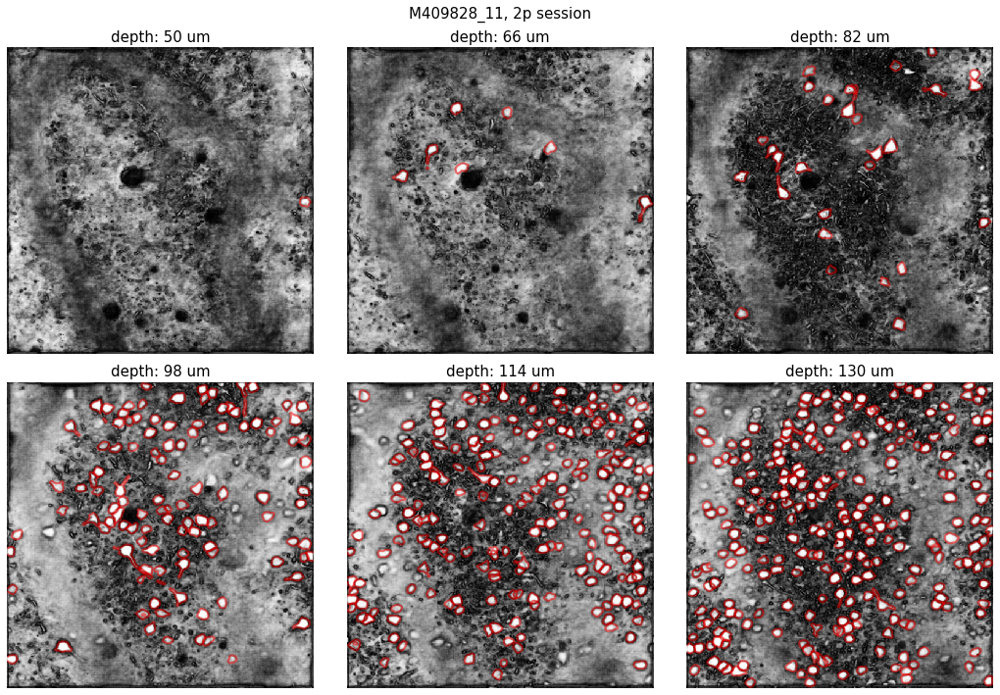

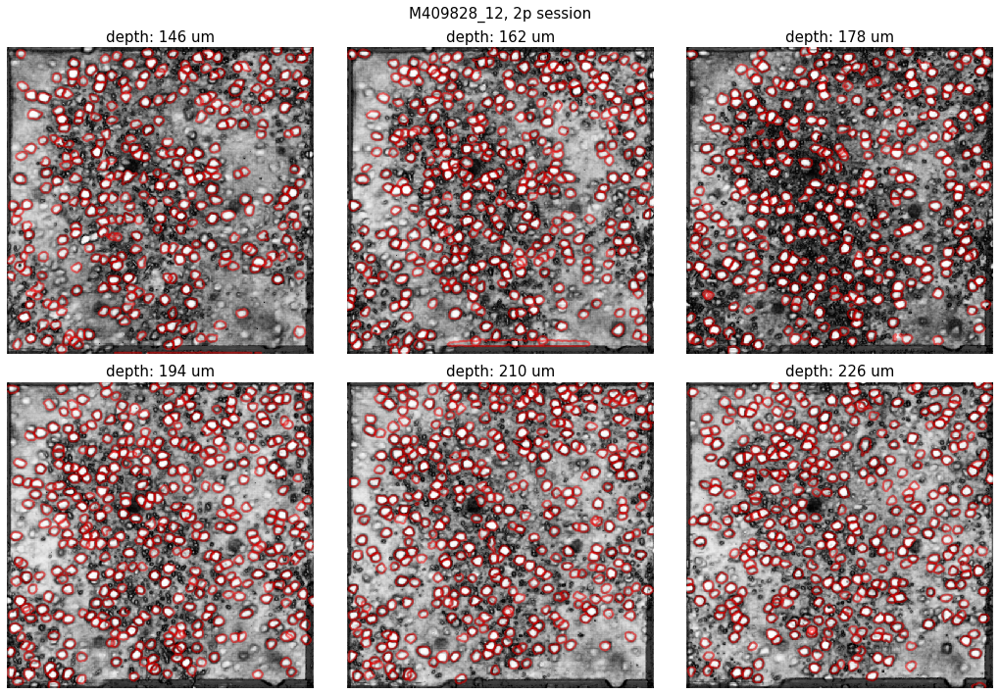

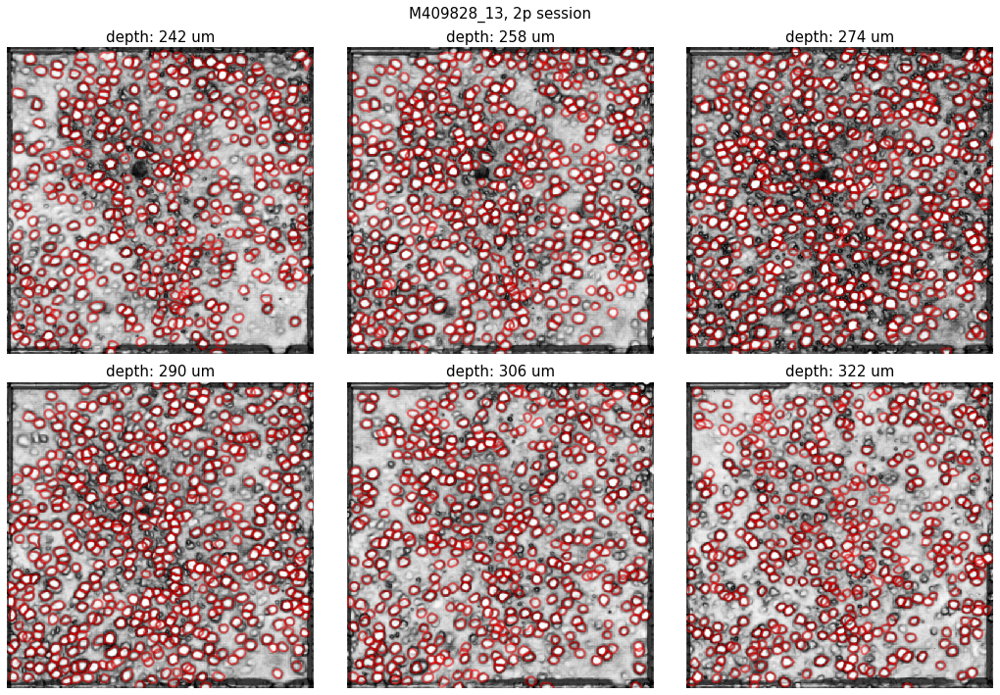

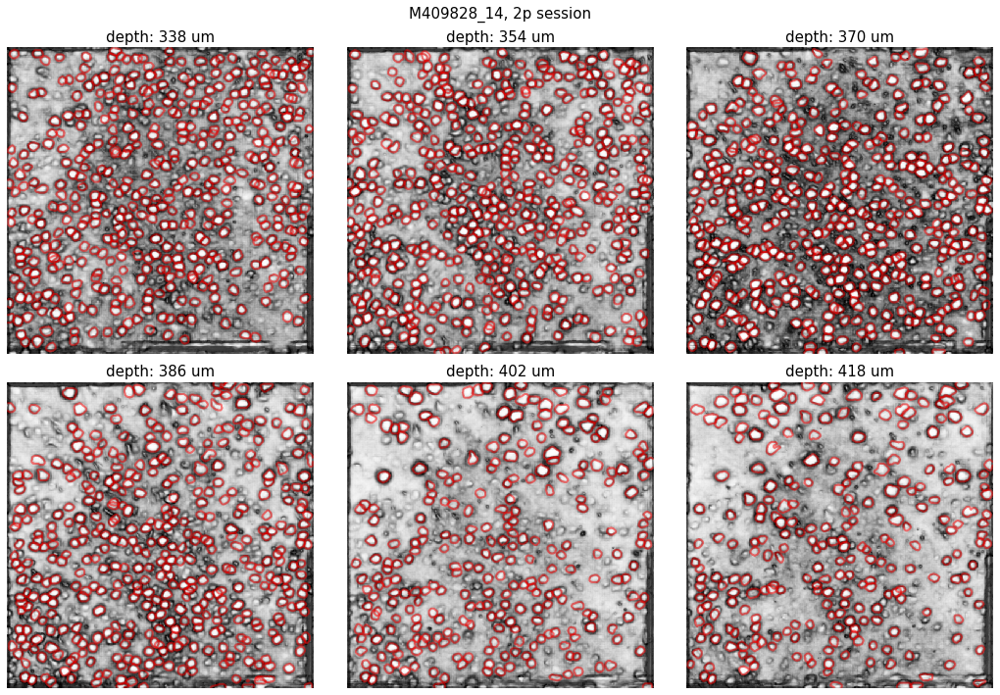

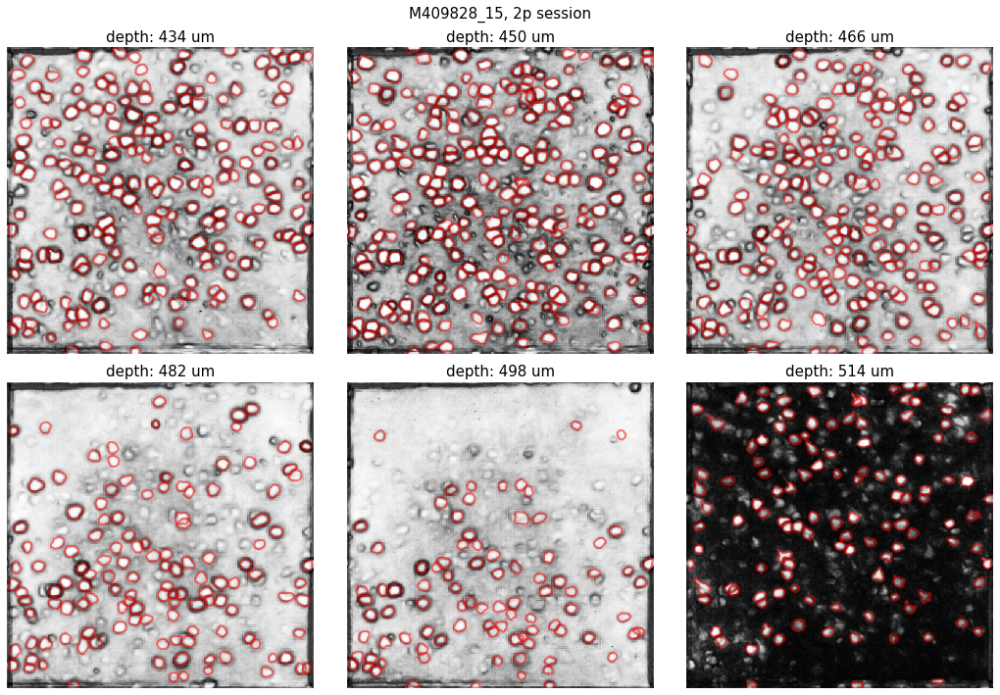

...

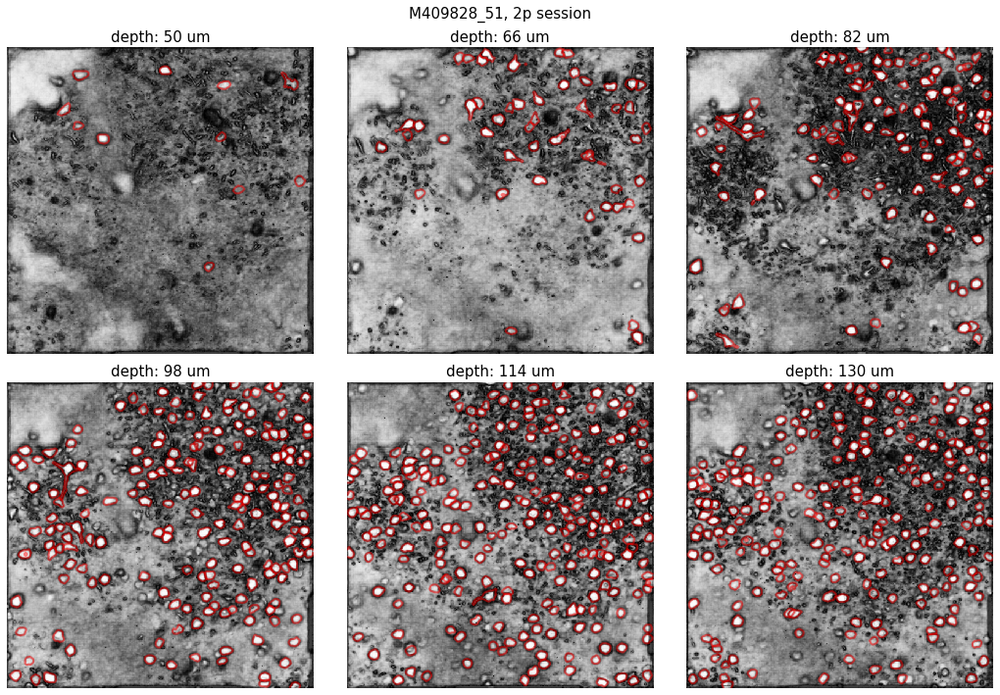

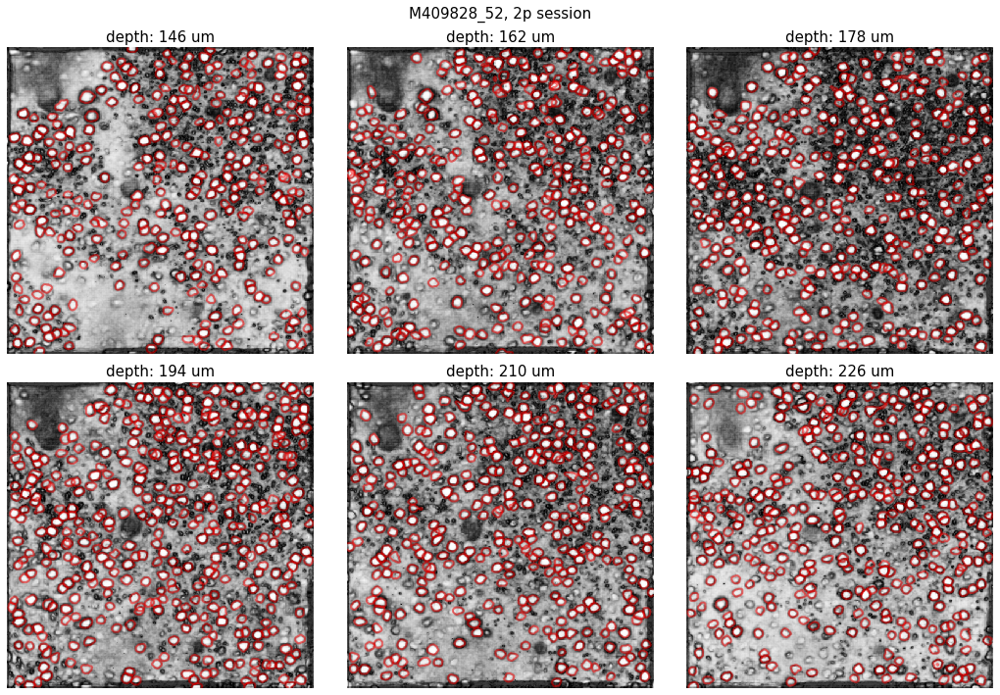

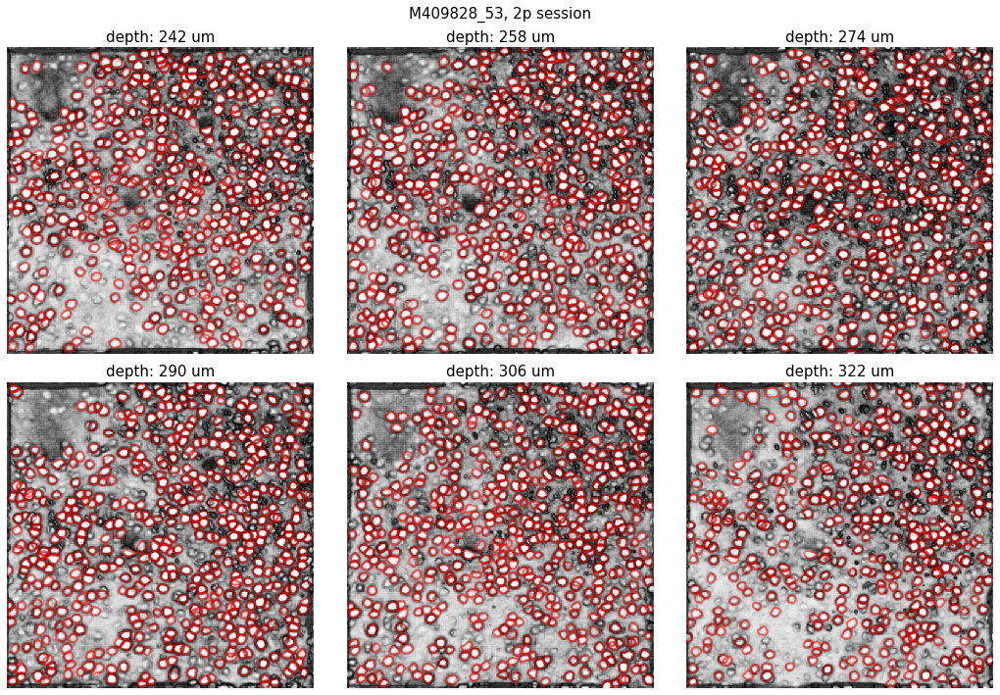

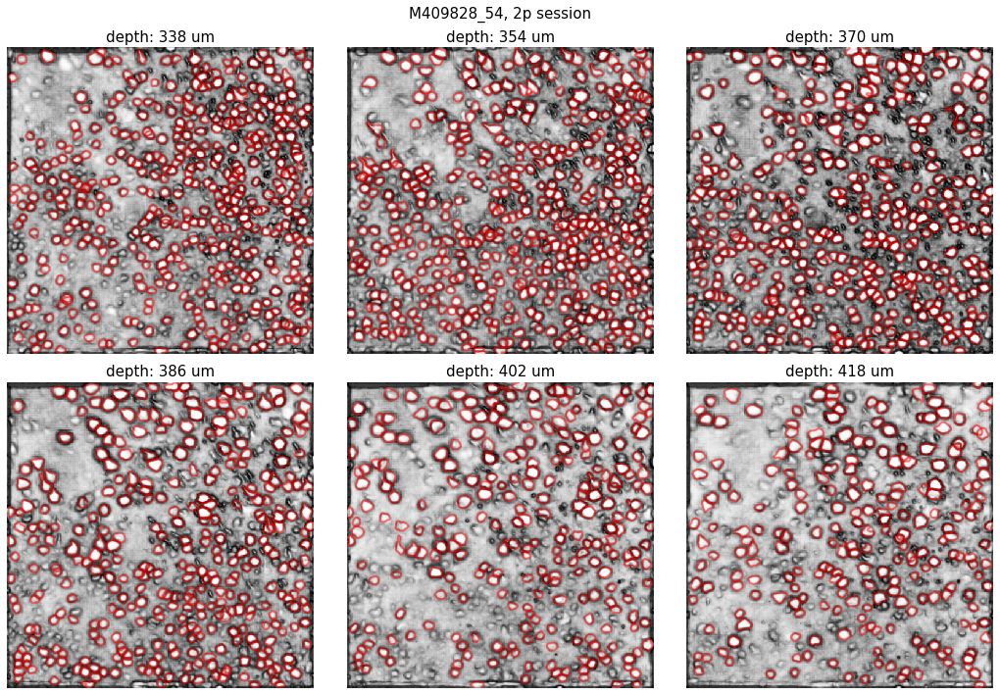

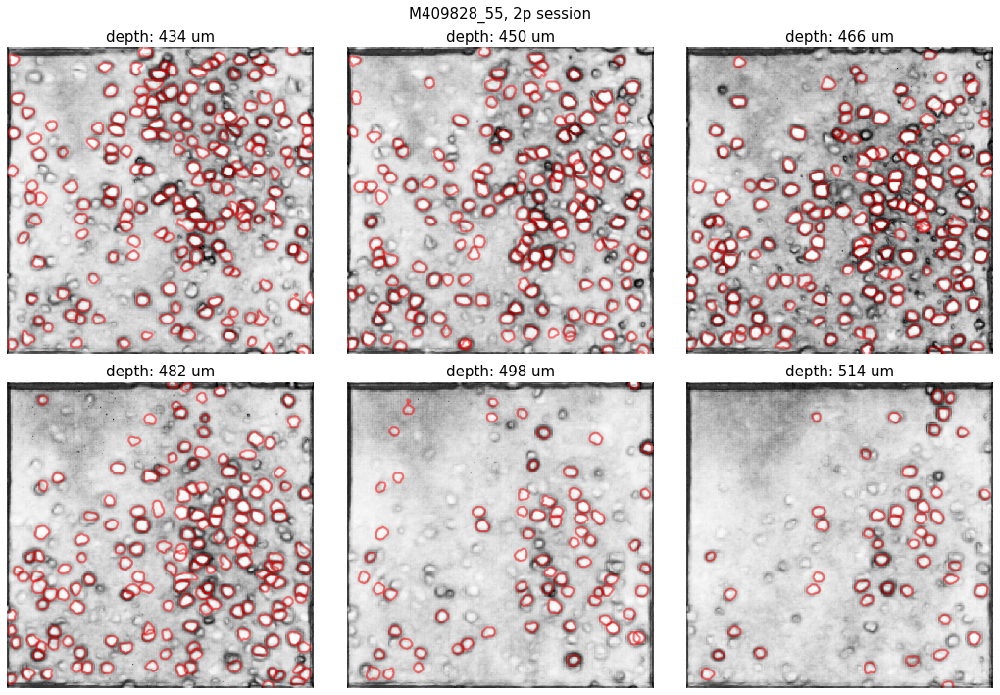

In [6]:
for nwb_fn in nwb_fns:
    nwb_f = h5py.File(os.path.join(nwb_folder, nwb_fn), 'r')
    
    if daf.get_scope_type(nwb_f) == '3p':
        f, ax = plt.subplots(figsize=(10, 10))
        f.suptitle(f'{nwb_fn[0:10]}, 3p session', fontsize=15)
        plot_plane_rois(nwb_f=nwb_f, plane_n='plane0', ax=ax)
        
    else:
        f, axs = plt.subplots(ncols=3, nrows=2, figsize=(15, 10))
        f.suptitle(f'{nwb_fn[0:10]}, 2p session', fontsize=15)
        axs = axs.flat
        for plane_i in range(6):
            plot_plane_rois(nwb_f=nwb_f, plane_n=f'plane{plane_i}', ax=axs[plane_i])